In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"]="1"

In [2]:
import numpy as np
import torch
import scanpy as sc
import muon as mu
import anndata
import mudata
import pandas as pd

print(anndata.__version__)
print(mudata.__version__)
print(sc.__version__)
print(torch.__version__)

0.8.0
0.2.1
1.9.2
1.11.0


In [3]:
%load_ext autoreload
%autoreload 2

In [21]:
from src.vae.diagnostics import plot_spatial, plot_embedding
from src.types import TrainParams
from src.vae.model import VAE, ModelParams
from src.vae.train import train_vae

In [4]:
torch.manual_seed(2137)
np.random.seed(2137)

In [5]:
mdata = mu.read('/media/yob/nacho_stuff/prostate_cancer/Integration/MVAE-PoE/OtF-prostate/data/mdata_preprocessed_final_filtered.h5mu')

In [6]:
adata = mdata.mod["msi"]
sc.pp.normalize_total(adata, target_sum=1e4)

## Unintegrated

In [15]:
sc.tl.pca(adata)
adata.obsm["Unintegrated"] = adata.obsm["X_pca"]
sc.pp.neighbors(adata, use_rep="Unintegrated", n_neighbors=30)
sc.tl.umap(adata)

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


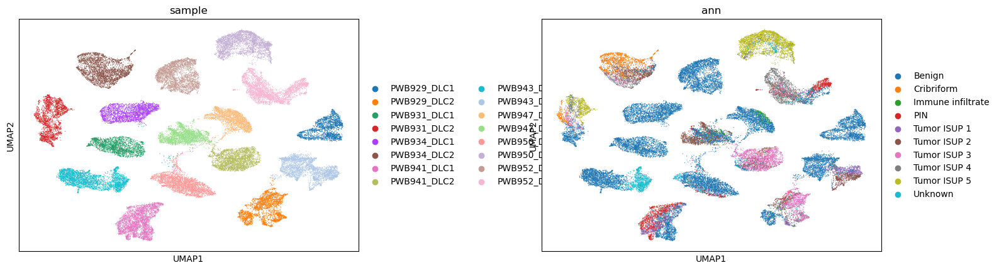

In [16]:
sc.pl.umap(adata, color=["sample", "ann"], wspace=0.4)

0.9012627523721196


/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


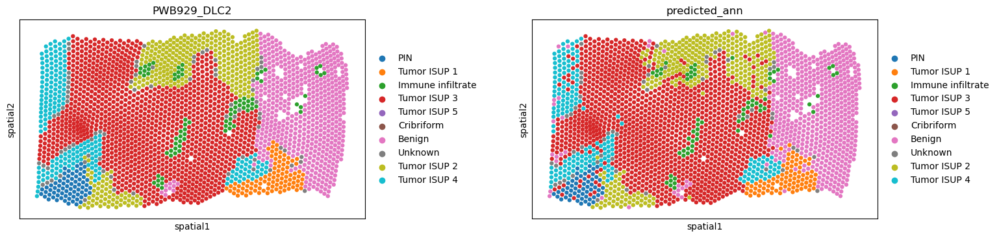

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


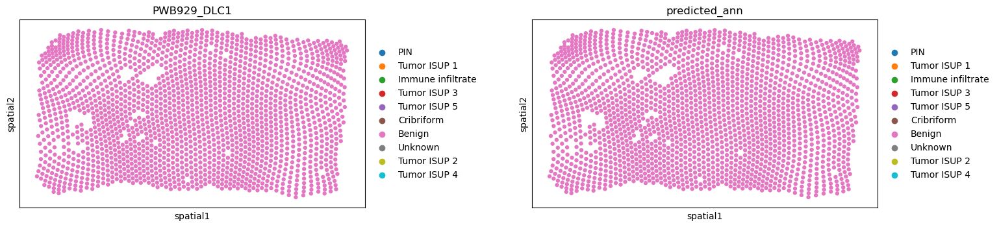

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


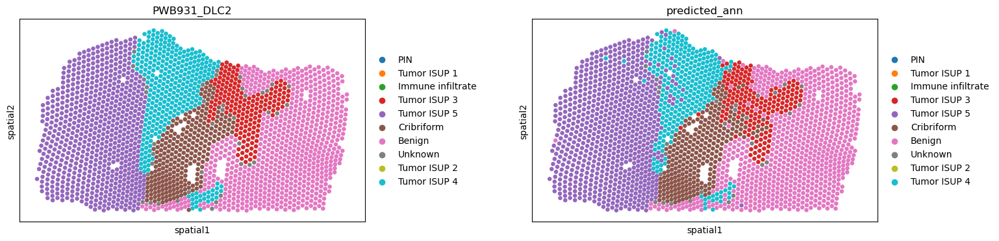

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


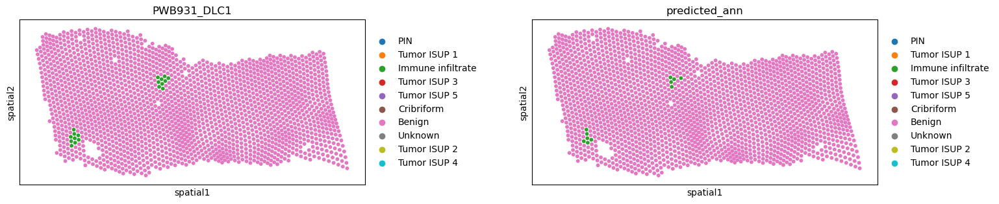

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


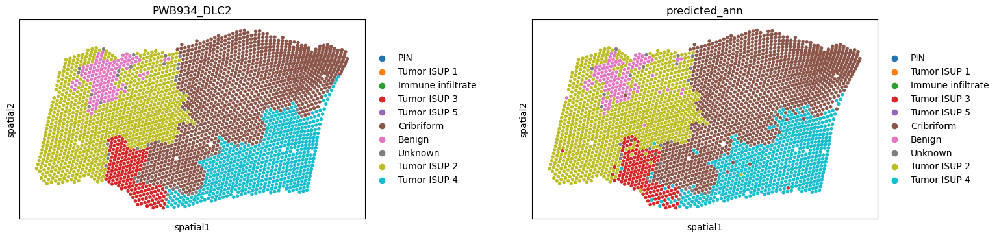

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


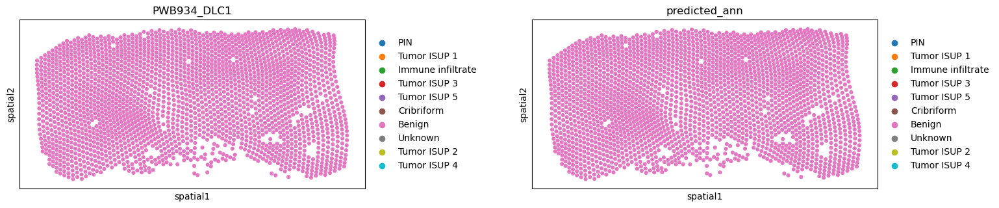

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


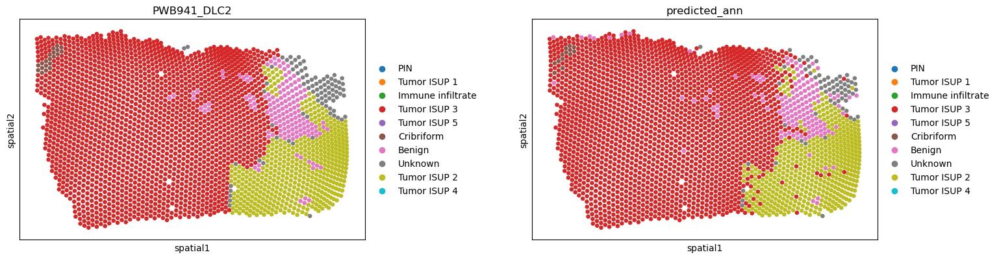

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


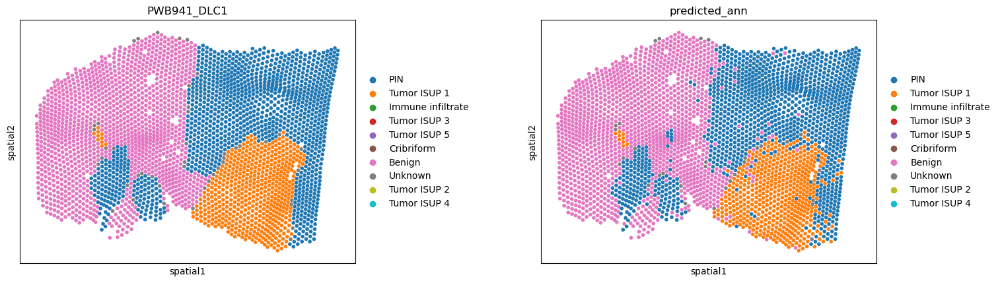

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


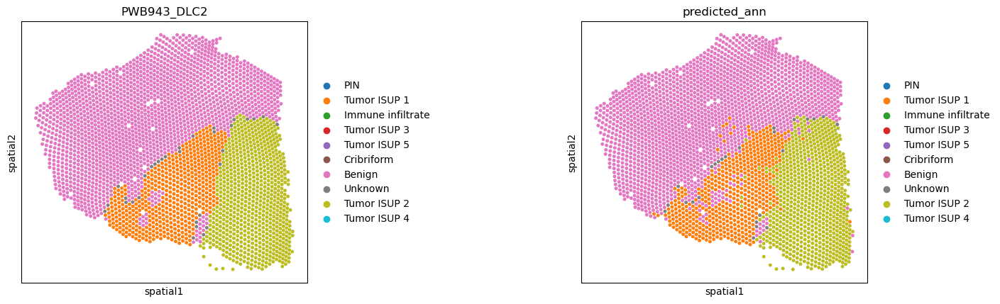

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


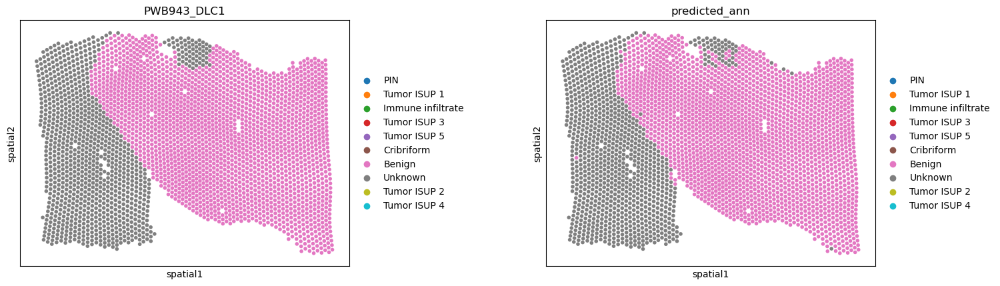

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


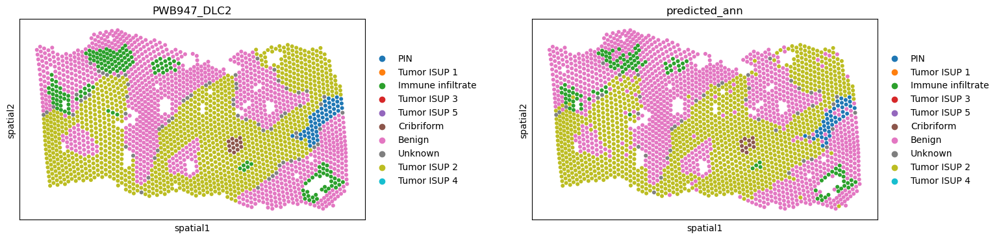

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


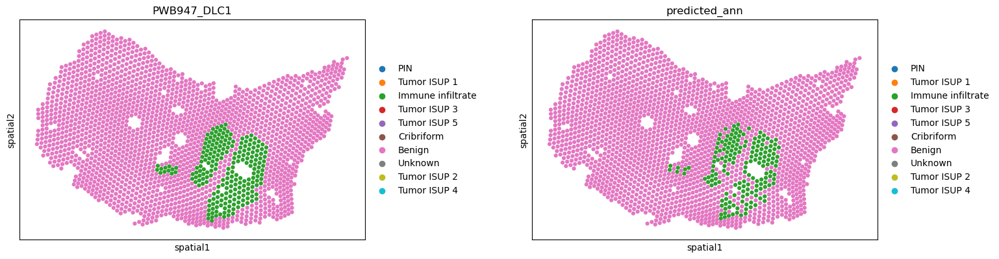

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


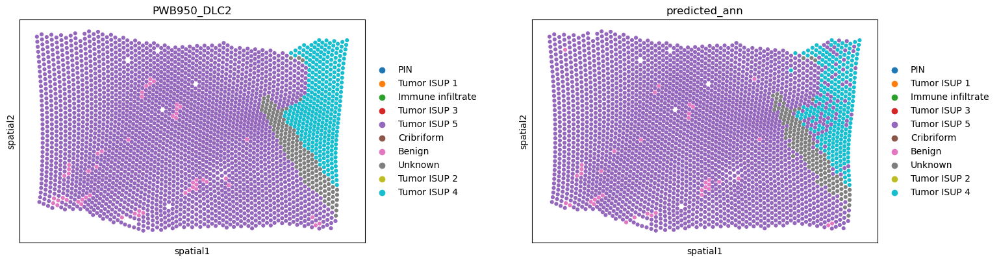

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


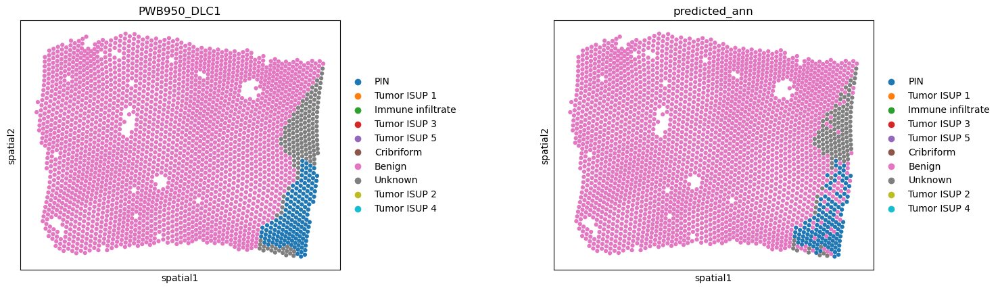

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


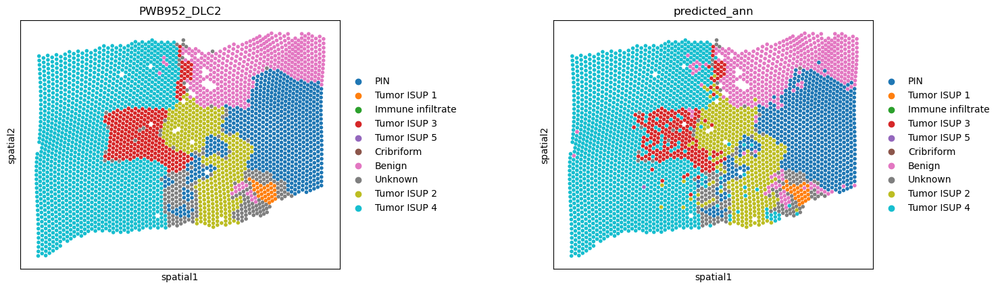

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


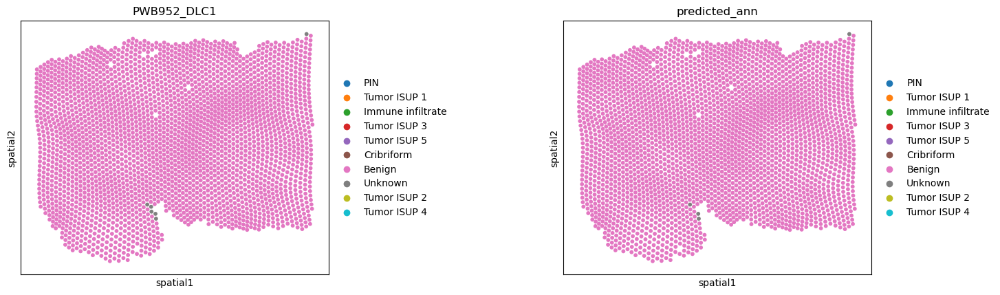

In [19]:
plot_spatial(adata, embed_key="Unintegrated")

## Harmony

In [10]:
import scanpy.external as sce
sce.pp.harmony_integrate(adata, 'sample')

2023-04-22 14:09:31,467 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/threadpoolctl.py:762: RuntimeWarning: 
Found Intel OpenMP ('libiomp') and LLVM OpenMP ('libomp') loaded at
the same time. Both libraries are known to be incompatible and this
can cause random crashes or deadlocks on Linux when loaded in the
same Python program.
Using threadpoolctl may cause crashes or deadlocks. For more
information and possible workarounds, please see
    https://github.com/joblib/threadpoolctl/blob/master/multiple_openmp.md

  warnings.warn(msg, RuntimeWarning)
2023-04-22 14:09:40,485 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-04-22 14:09:40,617 - harmonypy - INFO - Iteration 1 of 10
2023-04-22 14:09:49,598 - harmonypy - INFO - Iteration 2 of 10
2023-04-22 14:09:58,583 - harmonypy - INFO - Iteration 3 of 10
2023-04-22 14:10:07,542 - harmonypy - INFO - Iteration 4 of 1

In [11]:
adata.obsm["Harmony"] = adata.obsm["X_pca_harmony"]

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


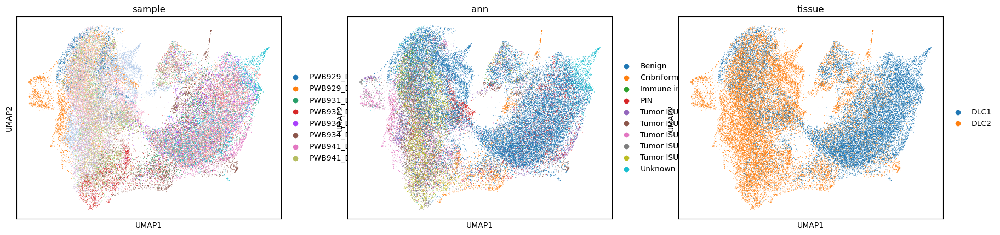

In [35]:
sc.pp.neighbors(adata, use_rep="Harmony", n_neighbors=30)
sc.tl.umap(adata)
sc.pl.umap(adata, color=["sample", "ann", "tissue"])

0.7782692444888349


/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


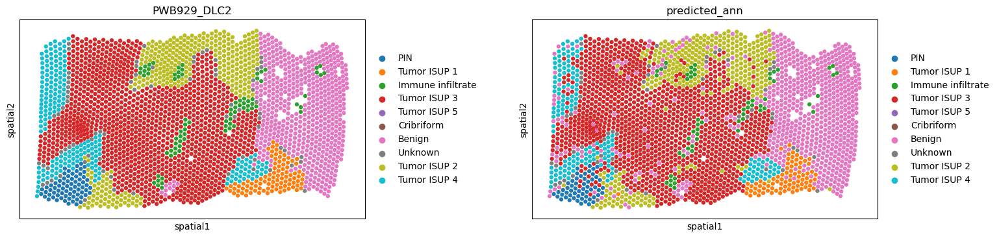

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


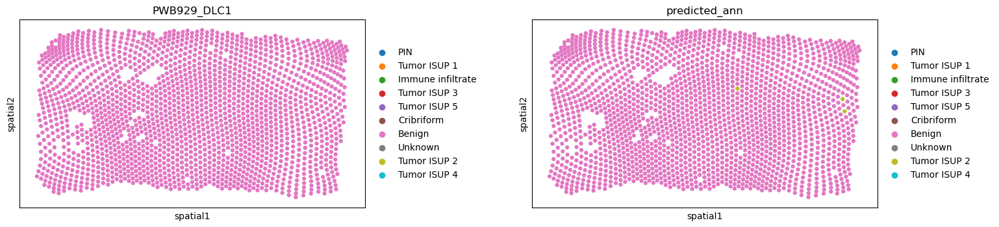

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


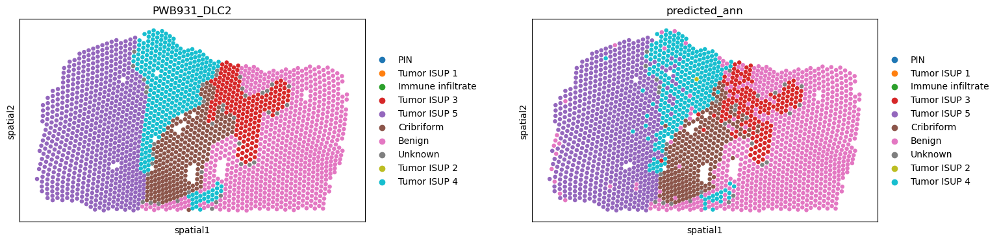

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


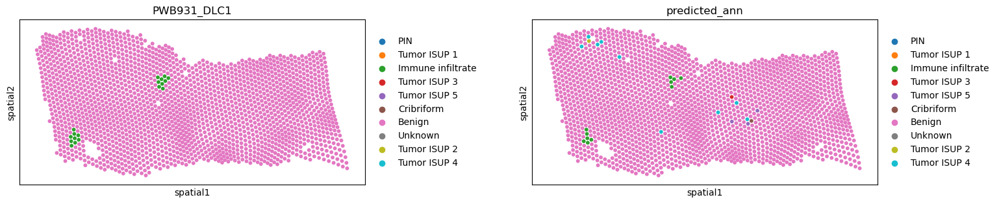

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


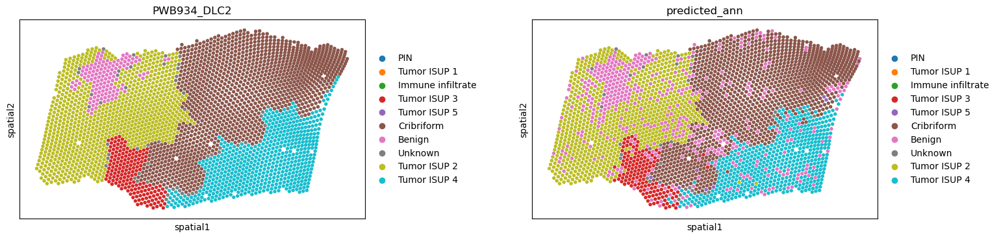

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


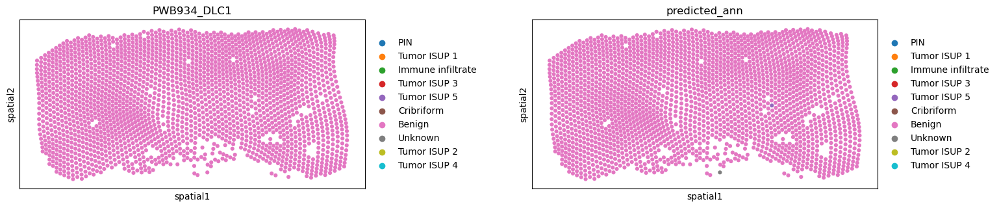

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


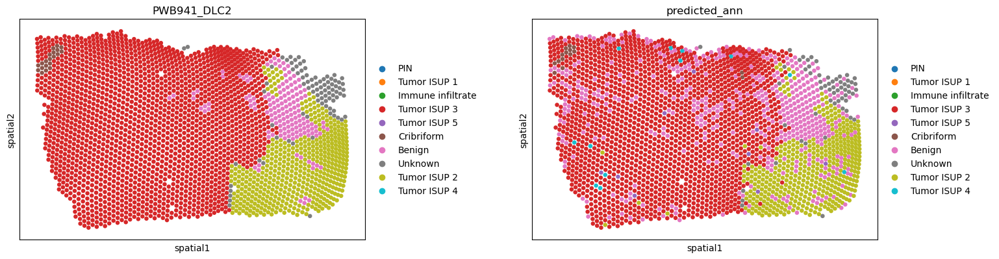

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


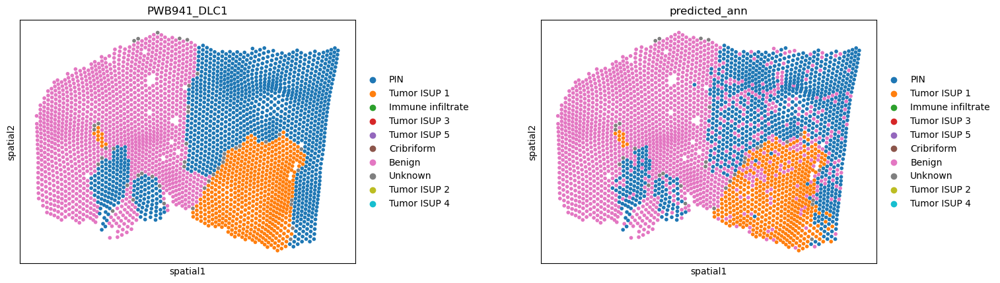

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


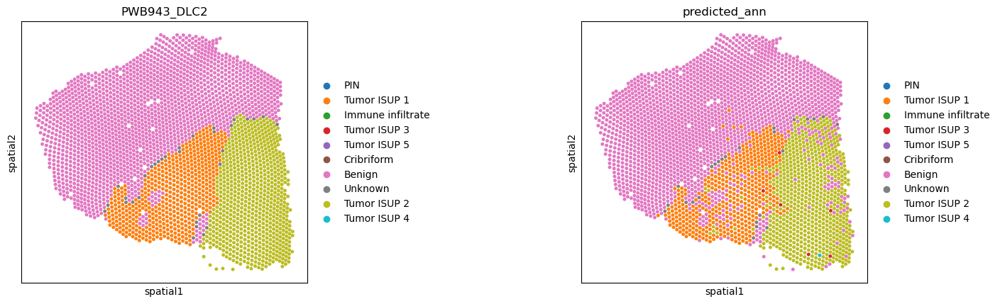

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


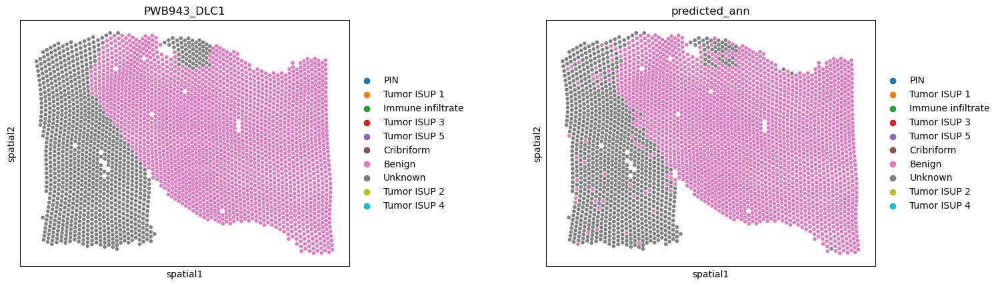

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


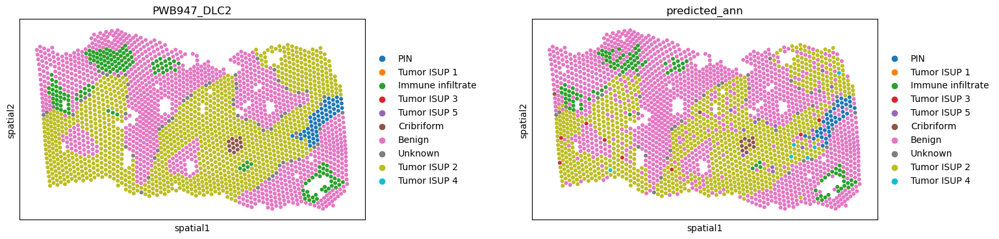

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


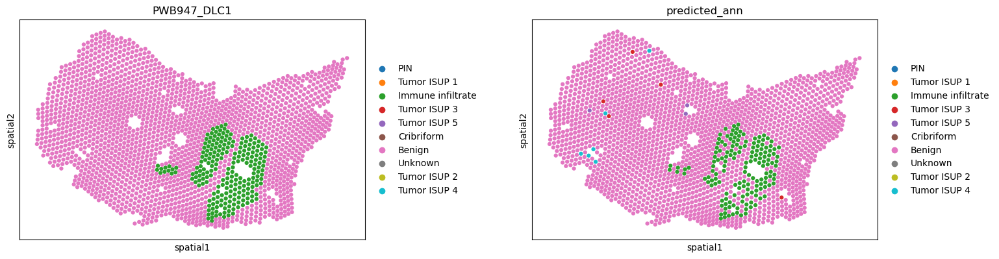

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


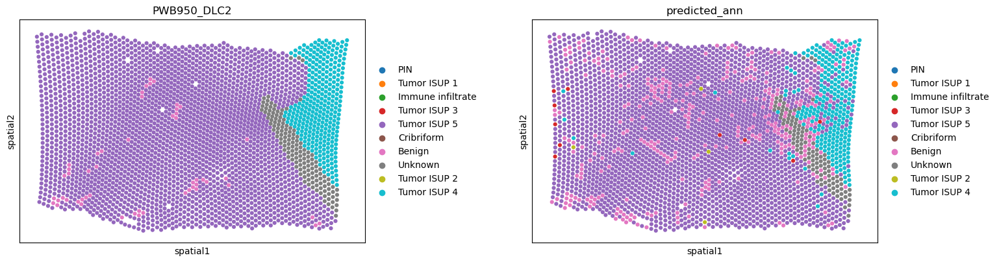

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


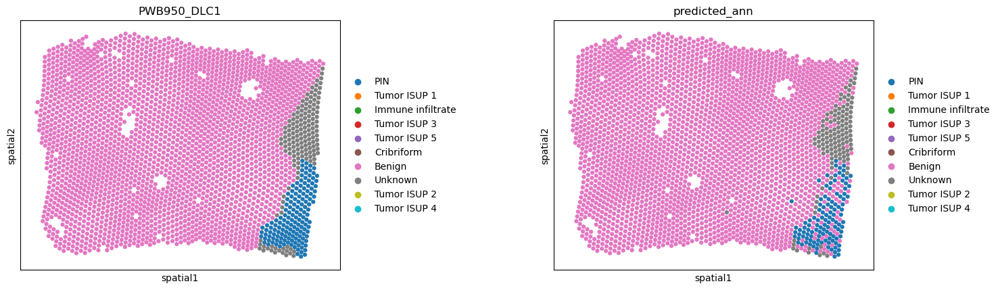

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


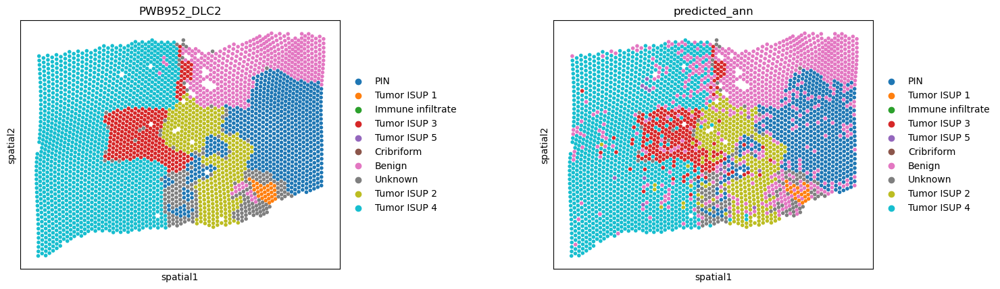

/media/gambino/students_workdir/anna/OtF-prostate/src/vae/diagnostics.py:101: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  mdata_tmp.obs[label_key] = mdata_tmp.obs[label_key].cat.add_categories(


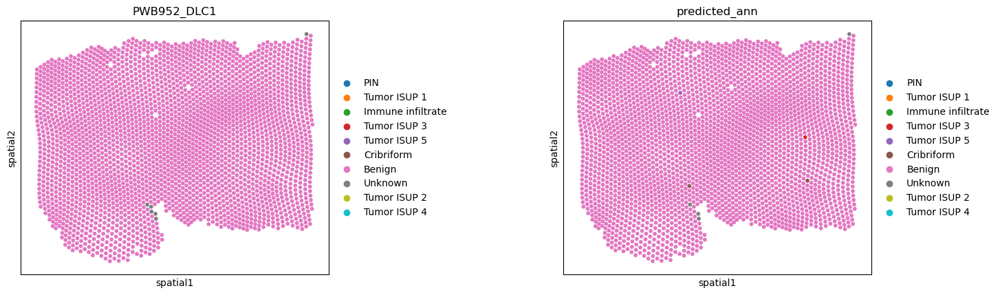

In [20]:
plot_spatial(adata, embed_key="Harmony")

## scVI

In [45]:
adata_scvi = sc.read("reports/scvi_prostate_msi.h5ad")
adata_scvi

AnnData object with n_obs × n_vars = 42475 × 12510
    obs: 'ST_barcode', 'sample', 'tissue', 'patient', 'ann', 'imagerow', 'imagecol', '_scvi_batch', '_scvi_labels'
    uns: '_scvi_manager_uuid', '_scvi_uuid'
    obsm: 'scVI', 'spatial'

In [46]:
adata.obsm["scVI"] = adata_scvi.obsm["scVI"]

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


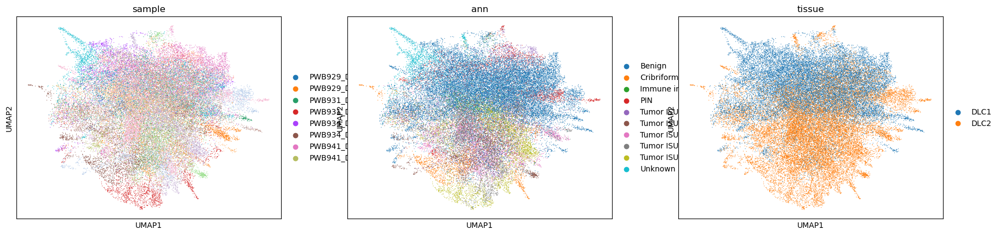

In [49]:
sc.pp.neighbors(adata, use_rep="scVI", n_neighbors=30)
sc.tl.umap(adata)
sc.pl.umap(adata, color=["sample", "ann", "tissue"])

## VAE

In [24]:
train_params = TrainParams(train_size=0.8, n_epochs=100, learning_rate=1e-4, batch_size=128, params_file="prostate__msi_0.05priv")
model_params = ModelParams(beta=0.01, n_layers=2, z_dim=100, n_hidden=300, use_cuda=True)
torch.set_num_threads(16)
model = VAE(adata, model_params)

# hist = train_vae(model, adata, batch_keys=["sample"], params=train_params)
model.load_state_dict(torch.load("mvae_params/prostate__msi_0.05priv_20230422-142058.pt"))

<All keys matched successfully>

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


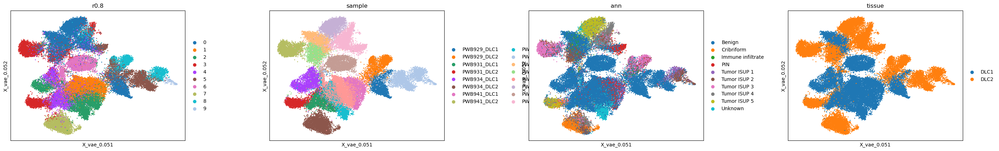

In [34]:
plot_embedding(model, adata, keys=["sample", "ann", "tissue"], batch_keys=["sample"], train_params=train_params)

In [28]:
adata.obsm["X_vae_0.05"] = adata.obsm["X_vae"]

In [29]:
train_params = TrainParams(train_size=0.8, n_epochs=100, learning_rate=1e-4, batch_size=128, params_file="prostate__msi_0.1priv")
model_params = ModelParams(beta=0.01, n_layers=2, z_dim=100, n_hidden=300, use_cuda=True)
torch.set_num_threads(16)
model = VAE(adata, model_params)

hist = train_vae(model, adata, batch_keys=["sample"], params=train_params)

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:20<00:00,  1.89it/s]

EarlyStopping (epoch: 1): train loss improved to 0.04764656959525833



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:29<00:00,  2.24it/s]

EarlyStopping (epoch: 1): valid loss improved to 5.594228701805001



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:22<00:00,  1.87it/s]

EarlyStopping (epoch: 2): train loss improved to 0.025116169635094637



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:30<00:00,  2.23it/s]

EarlyStopping (epoch: 2): valid loss improved to 3.2270066809298386



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:30<00:00,  2.22it/s]

EarlyStopping (epoch: 3): valid loss improved to 2.808460484689741



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:30<00:00,  2.22it/s]

EarlyStopping (epoch: 4): valid loss improved to 2.569446296834234



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:30<00:00,  2.19it/s]

EarlyStopping (epoch: 5): valid loss improved to 2.514028787612915



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:30<00:00,  2.18it/s]

EarlyStopping (epoch: 8): valid loss improved to 2.4975289052991725



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:30<00:00,  2.19it/s]

EarlyStopping (epoch: 9): valid loss improved to 2.4534548965852654



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:22<00:00,  1.86it/s]

EarlyStopping (epoch: 12): train loss hasn't improved: 0.0175693814090731. Stopping.



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:30<00:00,  2.17it/s]

EarlyStopping (epoch: 12): valid loss improved to 2.4324171738838083



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:22<00:00,  1.87it/s]

EarlyStopping (epoch: 13): train loss hasn't improved: 0.01746252000577454. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:22<00:00,  1.87it/s]

EarlyStopping (epoch: 14): train loss hasn't improved: 0.0173653580778974. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:22<00:00,  1.87it/s]

EarlyStopping (epoch: 15): train loss hasn't improved: 0.017381614937790706. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:23<00:00,  1.86it/s]

EarlyStopping (epoch: 16): train loss hasn't improved: 0.017308078954471007. Stopping.



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:30<00:00,  2.18it/s]

EarlyStopping (epoch: 16): valid loss improved to 2.4149703801567877



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:22<00:00,  1.86it/s]

EarlyStopping (epoch: 21): train loss hasn't improved: 0.01717072814404789. Stopping.



100%|████████████████████████████████████████████████████████████████████████| 67/67 [00:31<00:00,  2.15it/s]

EarlyStopping (epoch: 21): valid loss improved to 2.3596455517099866



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:22<00:00,  1.87it/s]

EarlyStopping (epoch: 22): train loss hasn't improved: 0.017070532844935257. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:22<00:00,  1.86it/s]

EarlyStopping (epoch: 23): train loss hasn't improved: 0.01705247832439169. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:22<00:00,  1.86it/s]

EarlyStopping (epoch: 24): train loss hasn't improved: 0.01698663831809607. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:22<00:00,  1.87it/s]

EarlyStopping (epoch: 25): train loss hasn't improved: 0.016998641900696287. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:22<00:00,  1.87it/s]

EarlyStopping (epoch: 26): train loss hasn't improved: 0.01700905966997287. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:21<00:00,  1.88it/s]

EarlyStopping (epoch: 27): train loss hasn't improved: 0.01691756871183035. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:22<00:00,  1.87it/s]

EarlyStopping (epoch: 28): train loss hasn't improved: 0.016927480104742786. Stopping.



100%|██████████████████████████████████████████████████████████████████████| 266/266 [02:22<00:00,  1.87it/s]

EarlyStopping (epoch: 29): train loss hasn't improved: 0.016889515401616807. Stopping.



 11%|███████▍                                                               | 28/266 [00:16<02:05,  1.89it/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


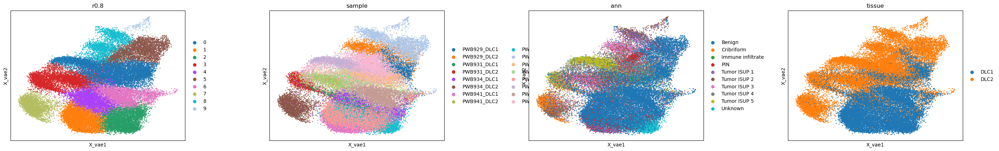

In [33]:
plot_embedding(model, adata, keys=["sample", "ann", "tissue"], batch_keys=["sample"], train_params=train_params)

In [32]:
adata.obsm["X_vae_0.1"] = adata.obsm["X_vae"]

## HVG

In [39]:
hvg = mdata.mod["msi"]
sc.pp.normalize_total(hvg, target_sum=1e4)
sc.pp.highly_variable_genes(hvg, n_top_genes=2000, flavor="cell_ranger", batch_key="sample")

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:485: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:485: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:485: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  hvg = hvg.append(missing_hvg, ignore_index=True)
/media/gambino/students_workdir/anna/min

In [40]:
sc.tl.pca(hvg, n_comps=30, use_highly_variable=True)
hgv = hvg[:, hvg.var.highly_variable]

/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


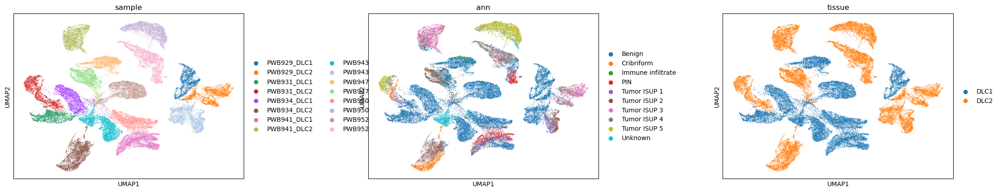

In [42]:
sc.pp.neighbors(hgv, n_neighbors=30)
sc.tl.umap(hgv)
sc.pl.umap(hgv, color=["sample", "ann", "tissue"], wspace=0.4)

In [43]:
import scanpy.external as sce
sce.pp.harmony_integrate(hgv, 'sample')

2023-04-23 14:14:53,500 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-04-23 14:14:59,421 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-04-23 14:14:59,560 - harmonypy - INFO - Iteration 1 of 10
2023-04-23 14:15:08,978 - harmonypy - INFO - Iteration 2 of 10
2023-04-23 14:15:18,271 - harmonypy - INFO - Iteration 3 of 10
2023-04-23 14:15:27,562 - harmonypy - INFO - Iteration 4 of 10
2023-04-23 14:15:36,831 - harmonypy - INFO - Iteration 5 of 10
2023-04-23 14:15:46,111 - harmonypy - INFO - Converged after 5 iterations


/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


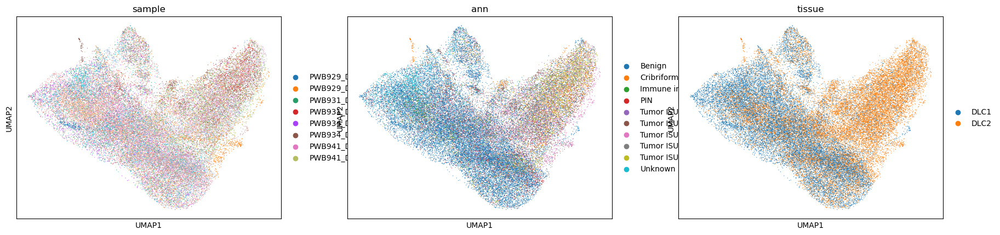

In [44]:
sc.pp.neighbors(hgv, use_rep="X_pca_harmony", n_neighbors=30)
sc.tl.umap(hgv)
sc.pl.umap(hgv, color=["sample", "ann", "tissue"])

## Benchmark

In [47]:
from scib_metrics.benchmark import Benchmarker
bm = Benchmarker(
    adata,
    batch_key="sample",
    label_key="ann",
    embedding_obsm_keys=["Unintegrated", "X_vae_0.1", "X_vae_0.05", "Harmony", "scVI"],
    n_jobs=16,
)
bm.benchmark()

Metrics:   0%|                                     | 0/10 [00:00<?, ?it/s, Bio conservation: isolated_labels]WARNING:jax._src.lib.xla_bridge:No GPU/TPU found, falling back to CPU. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)

Metrics:   0%|                                                                        | 0/10 [00:00<?, ?it/s]
                                                                                                             
Metrics:  80%|████████████████████████      | 8/10 [00:40<00:21, 10.88s/it, Batch correction: pcr_comparison]/media/gambino/students_workdir/anna/miniconda3/envs/ak/lib/python3.9/site-packages/scib_metrics/_pcr_comparison.py:49: UserWarning: PCR comparison score is negative, meaning variance contribution increased after integration. Setting to 0.
  warnings.warn(

Metrics:   0%|                                                                        | 0/10 [00:00<?, ?it/s]
                                                                    

Metrics:   0%|                                                                        | 0/10 [00:00<?, ?it/s]
                                                                                                             
Embeddings: 100%|██████████████████████████████████████████████████████████████| 5/5 [07:40<00:00, 92.07s/it]

                                                                                                             

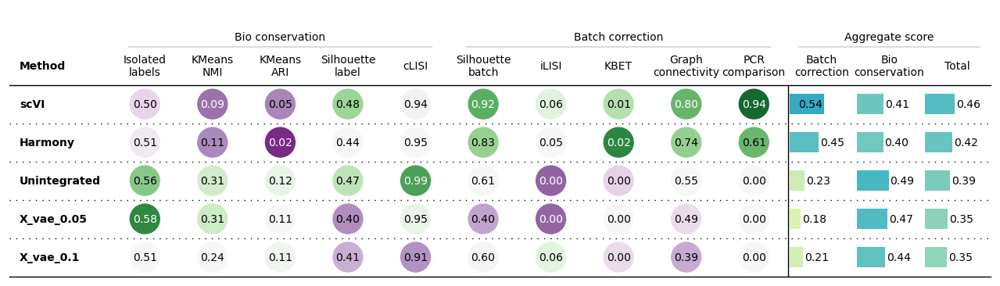

In [48]:
bm.plot_results_table(min_max_scale=False)

# Classification

## Predict ann

In [50]:
from src.vae.diagnostics import classification_performance
classification_performance(adata, embed_key="Unintegrated")

(0.8992651779981451, RandomForestClassifier())

In [51]:
classification_performance(adata, embed_key="X_vae_0.1")

(0.6482842262966398, RandomForestClassifier())

In [52]:
classification_performance(adata, embed_key="X_vae_0.05")

(0.7299707498038096, RandomForestClassifier())

In [53]:
classification_performance(adata, embed_key="Harmony")

(0.7781265606049796, RandomForestClassifier())

In [54]:
classification_performance(adata, embed_key="scVI")

(0.7190554326888778, RandomForestClassifier())

## Predict cancer/normal

In [55]:
classification_performance(adata, embed_key="Unintegrated", label_key="tissue")

(0.9992865805807234, RandomForestClassifier())

In [57]:
classification_performance(adata, embed_key="X_vae_0.1", label_key="tissue")

(0.8768638082328601, RandomForestClassifier())

In [58]:
classification_performance(adata, embed_key="X_vae_0.05", label_key="tissue")

(0.9577655703788257, RandomForestClassifier())

In [56]:
classification_performance(adata, embed_key="Harmony", label_key="tissue")

(0.9054719269458514, RandomForestClassifier())

In [59]:
classification_performance(adata, embed_key="scVI", label_key="tissue")

(0.8756509952200899, RandomForestClassifier())

## Predict ann (balanced)

In [60]:
classification_performance(adata, embed_key="Unintegrated", test_size=0.5)

(0.8962237498822865, RandomForestClassifier())

In [61]:
classification_performance(adata, embed_key="X_vae_0.1", test_size=0.5)

(0.6480836236933798, RandomForestClassifier())

In [62]:
classification_performance(adata, embed_key="X_vae_0.05", test_size=0.5)

(0.7339203314813071, RandomForestClassifier())

In [63]:
classification_performance(adata, embed_key="Harmony", test_size=0.5)

(0.7698465015538186, RandomForestClassifier())

In [64]:
classification_performance(adata, embed_key="scVI", test_size=0.5)

(0.7106130520764667, RandomForestClassifier())

## Predict LOO

In [79]:
from collections import defaultdict
methods = ["Unintegrated", "X_vae_0.1", "X_vae_0.05", "Harmony", "scVI"]
class_perf = defaultdict(dict)

In [80]:
for method in methods:
    print(method)
    for sample in adata.obs["sample"].unique():
        class_perf[method][sample] = classification_performance(adata, embed_key=method, loo=sample)[0]

Unintegrated
0.2223091976516634
1.0
0.3157181571815718
0.988780487804878
0.043850972634355424
1.0
0.05965583173996176
0.4212585588522987
0.5752921535893155
0.6779014308426073
0.42167689161554195
0.884324834749764
0.02142857142857143
0.8908829863603733
0.131425053862727
0.9979115906717717
X_vae_0.1
0.2563600782778865
0.7330246913580247
0.3206865401987353
0.9175609756097561
0.07451368282228817
0.9102341717259324
0.1349904397705545
0.4039778284969025
0.48580968280467446
0.6578696343402226
0.330879345603272
0.4749763928234183
0.06753246753246753
0.7921751615218952
0.12311480455524777
0.890706578489384
X_vae_0.05
0.17377690802348336
0.9933127572016461
0.3148148148148148
0.8585365853658536
0.043850972634355424
0.7077189939288812
0.060038240917782024
0.38408868601238993
0.5382303839732888
0.6779014308426073
0.34805725971370144
0.5288007554296507
0.05519480519480519
0.673007896625987
0.11819021237303785
0.7667942916811695
Harmony
0.25440313111545987
0.9475308641975309
0.37895212285456187
0.92


/tmp/ipykernel_1636128/170998287.py:6: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(labels=ax.get_xticklabels(), rotation=90)


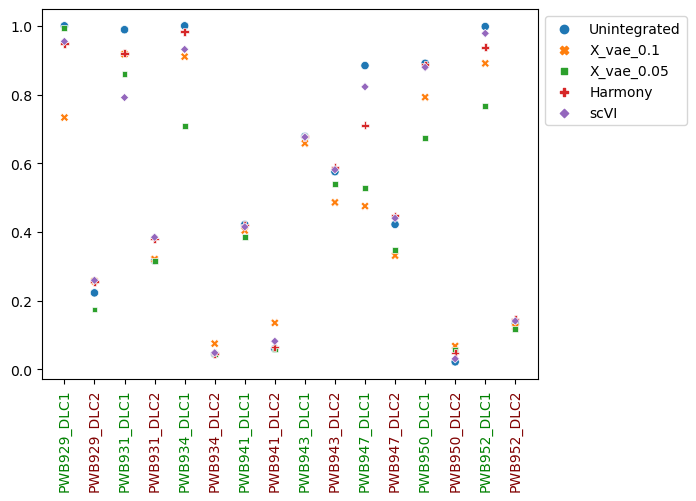

In [179]:
import seaborn as sns
cp = pd.DataFrame(class_perf).sort_index()
tissue = ["normal", "cancer"] * int(len(cp) / 2)
cp["tissue"] = tissue
ax = sns.scatterplot(data=cp)
ax.set_xticklabels(labels=ax.get_xticklabels(), rotation=90)
for tissue, tick_label in zip(tissue, ax.axes.get_xticklabels()):
    if tissue == "cancer":
        tick_label.set_color("maroon")
    else:
        tick_label.set_color("green")

sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

In [182]:
cp.groupby("tissue").mean()

,Unintegrated,X_vae_0.1,X_vae_0.05,Harmony,scVI
tissue,,,,,
cancer,0.223920,0.224236,0.206519,0.246478,0.245490
normal,0.857632,0.722566,0.698770,0.810285,0.805973


In [183]:
methods = ["Unintegrated", "X_vae_0.1", "X_vae_0.05", "Harmony", "scVI"]
class_perf = defaultdict(dict)

In [184]:
for method in methods:
    print(method)
    for sample in adata.obs["sample"].unique():
        class_perf[method][sample] = classification_performance(adata, embed_key=method, loo=sample, label_key="tissue")[0]

Unintegrated
X_vae_0.1
X_vae_0.05
Harmony
scVI


/tmp/ipykernel_1636128/170998287.py:6: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(labels=ax.get_xticklabels(), rotation=90)


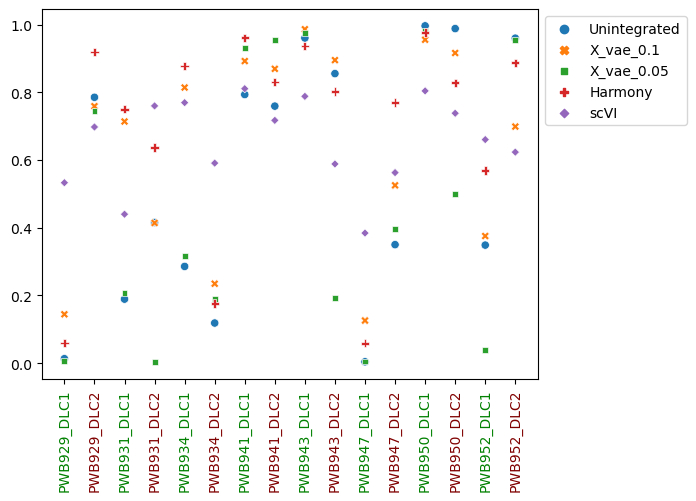

In [185]:
import seaborn as sns
cp = pd.DataFrame(class_perf).sort_index()
tissue = ["normal", "cancer"] * int(len(cp) / 2)
cp["tissue"] = tissue
ax = sns.scatterplot(data=cp)
ax.set_xticklabels(labels=ax.get_xticklabels(), rotation=90)
for tissue, tick_label in zip(tissue, ax.axes.get_xticklabels()):
    if tissue == "cancer":
        tick_label.set_color("maroon")
    else:
        tick_label.set_color("green")

sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

In [186]:
cp.groupby("tissue").mean()

,Unintegrated,X_vae_0.1,X_vae_0.05,Harmony,scVI
tissue,,,,,
cancer,0.653913,0.663952,0.491744,0.731206,0.659671
normal,0.448878,0.625877,0.432974,0.648605,0.648666
